In [1]:
## The following code ensures that all functions and init files are reloaded before executions.
%load_ext autoreload
%autoreload 2

In [2]:
from pathlib import Path
from insitupy import InSituData, InSituExperiment, CACHE
import scanpy as sc
from tqdm import tqdm
import numpy as np
import pandas as pd
sc.set_figure_params(dpi_save=600)


## Identify cancer subtypes

### Plan

#### DGE
- calculate differential expressed genes for each cell type and visualize them using a large grid to showcase the plotting functionalities
- annotate the tumor buds
- compare tumor buds vs non-tumor buds using differential gene expression analysis + GO term analysis
    - identify genes that are different across all samples
        - GO term enrichment analysis or similar way to check out these genes (StringDB gene network?)
    - This could be also a pseudobulk case: tumor bud vs bulk tumor using all samples as replicate?
- and visualize the tumor bud cells on UMAP to see their location

#### Cancer subtyping
- Subcluster cancer cell cluster and show cellular composition of Tumor vs tumor bud


#### Pseudobulk
- generate a pseudobulk version of the data and visualize it as heatmap


Load the scANVI results for subclustering

In [3]:
# scanvi path
scanvi_path = Path(r"E:\ColorectalCancer\analysis\scANVI\results_gpu__celltypist_rounded_5000_1e2__majority_voting_simple__nb_gene-batch_100_50\scanvi.h5ad")
scanvi = sc.read(scanvi_path)

In [4]:
scanvi

AnnData object with n_obs × n_vars = 1018411 × 280
    obs: 'original_cell_id', 'centroid_x', 'centroid_y', 'centroid_z', 'fov', 'cluster', 'volume', 'scale', 'population', 'n_genes_by_counts', 'total_counts', 'n_counts', 'n_genes', 'uid', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'majority_voting_simple', '_scvi_batch', '_scvi_labels'
    var: 'gene_names', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'X_umap_scanvi', 'X_umap_scvi', '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'neighbors', 'neighbors_scanvi', 'neighbors_scvi', 'over_clustering', 'pca', 'umap'
    obsm: 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'X_umap_scanvi', 'X_umap_scvi', 'spatial'
    varm: 'PCs'
    layers: 'counts', 'counts_proseg', 'counts_rounded', 'log1p', 'norm_counts', 'scaled_log1p'
    obsp: 'connectivities', 'distances', 'neighbors_scanvi_connectivities', 'neighbors_scanvi_distances', 'neighbors_scvi_connectivities', 'neighbors_scvi_dis

In [5]:
sample = sc.pp.sample(scanvi, n=100000, copy=True, rng=0)
#sample = sc.pp.sample(scanvi, n=50000, copy=True, rng=0)

In [6]:
sample

AnnData object with n_obs × n_vars = 100000 × 280
    obs: 'original_cell_id', 'centroid_x', 'centroid_y', 'centroid_z', 'fov', 'cluster', 'volume', 'scale', 'population', 'n_genes_by_counts', 'total_counts', 'n_counts', 'n_genes', 'uid', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'majority_voting_simple', '_scvi_batch', '_scvi_labels'
    var: 'gene_names', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'X_umap_scanvi', 'X_umap_scvi', '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'neighbors', 'neighbors_scanvi', 'neighbors_scvi', 'over_clustering', 'pca', 'umap'
    obsm: 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'X_umap_scanvi', 'X_umap_scvi', 'spatial'
    varm: 'PCs'
    layers: 'counts', 'counts_proseg', 'counts_rounded', 'log1p', 'norm_counts', 'scaled_log1p'
    obsp: 'connectivities', 'distances', 'neighbors_scanvi_connectivities', 'neighbors_scanvi_distances', 'neighbors_scvi_connectivities', 'neighbors_scvi_dist

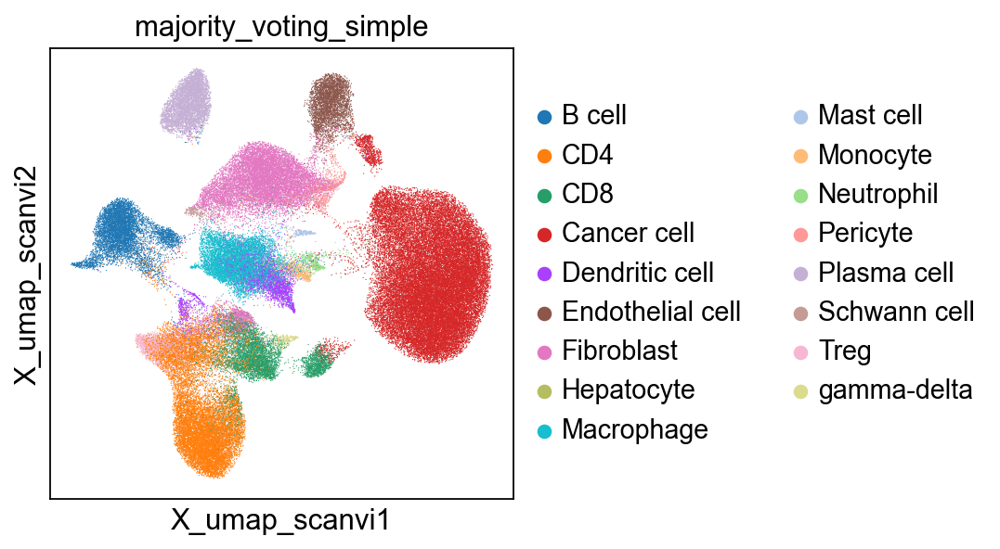

In [7]:
sc.pl.embedding(sample, basis="X_umap_scanvi", color="majority_voting_simple")

Select only the cancer cells in both the complete and the subsampled data.

In [40]:
cancer = scanvi[scanvi.obs["majority_voting_simple"] == "Cancer cell"].copy()
cancer_sample = sample[sample.obs["majority_voting_simple"] == "Cancer cell"].copy()

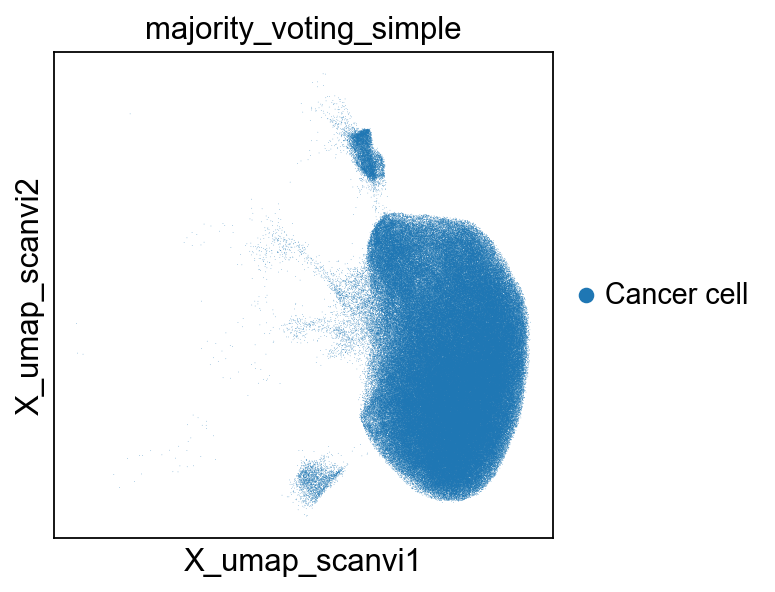

In [36]:
sc.pl.embedding(cancer, basis="X_umap_scanvi", color="majority_voting_simple")

Do the subclustering on the subsample.

In [47]:
sc.pp.neighbors(cancer_sample,
                use_rep="X_scANVI",
                key_added="neighbors_scanvi_sample")

#leiden_res = 0.4
leiden_res_list = [0.3, 0.4, 0.45, 0.5]
for leiden_res in leiden_res_list:
    print(leiden_res)
    sc.tl.leiden(cancer_sample,
                resolution=leiden_res,
                restrict_to=("majority_voting_simple", ["Cancer cell"]),
                key_added=f"cancer_cell_subclustered_{leiden_res}",
                neighbors_key="neighbors_scanvi_sample"
                )

0.3
0.4
0.45
0.5


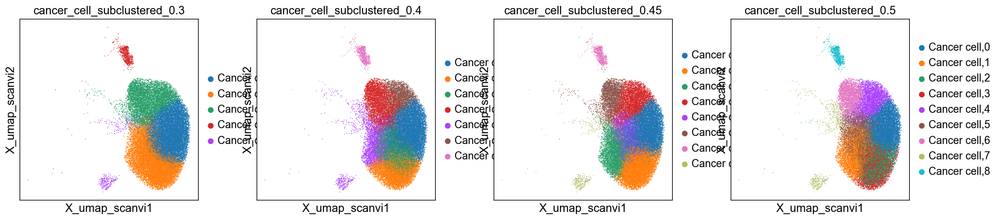

In [48]:
sc.pl.embedding(cancer_sample,
                basis="X_umap_scanvi",
                color=[f"cancer_cell_subclustered_{elem}" for elem in leiden_res_list])

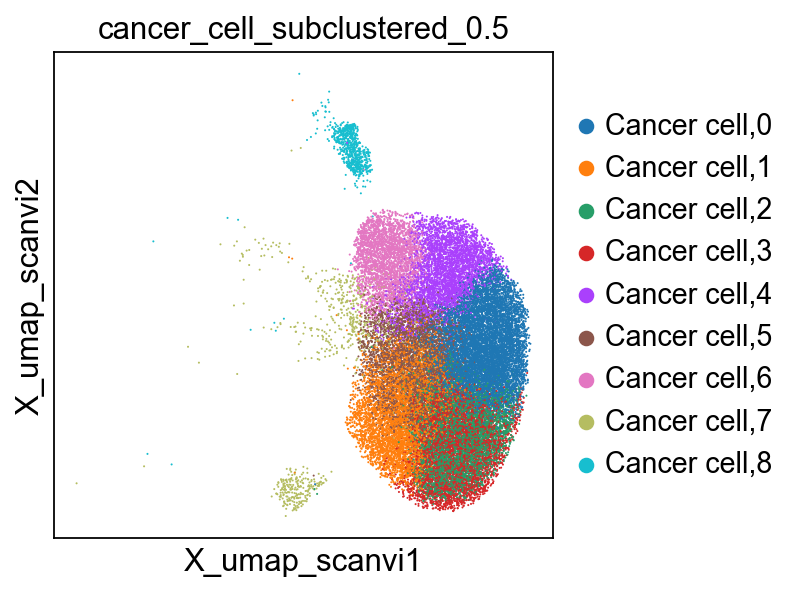

In [49]:
sc.pl.embedding(cancer_sample, basis="X_umap_scanvi", color=f"cancer_cell_subclustered_0.5")

Transfer the subclusters to the complete sample using `celltypist`.

In [55]:
import celltypist
model = celltypist.train(cancer_sample, 'cancer_cell_subclustered_0.5', check_expression=False)

🍳 Preparing data before training
🔬 Input data has 35806 cells and 280 genes
⚖️ Scaling input data
🏋️ Training data using logistic regression
✅ Model training done!


In [56]:
predictions = celltypist.annotate(cancer,
                                  model = model,
                                  majority_voting = False)

⚠️ Warning: invalid expression matrix, expect ALL genes and log1p normalized expression to 10000 counts per cell. The prediction result may not be accurate
🔬 Input data has 363143 cells and 280 genes
🔗 Matching reference genes in the model
🧬 280 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!


Transfer the predicted labels to the complete dataset

In [57]:
scanvi.obs["cancer_cell_subclusters_transferred"] = predictions.predicted_labels["predicted_labels"]

In [58]:
vals = []
for a, b in zip(scanvi.obs["cancer_cell_subclusters_transferred"], scanvi.obs["majority_voting_simple"]):
    if pd.isna(a):
        vals.append(b)
    else:
        vals.append(a)

# add values to obs
scanvi.obs["cancer_cell_subclusters_transferred_comb"] = vals

... storing 'uid' as categorical


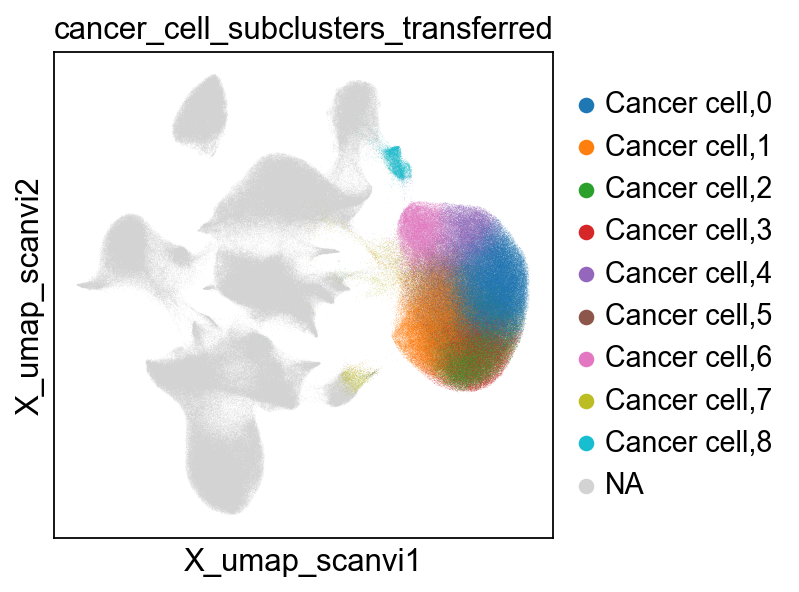

In [78]:
from insitupy._constants import DEFAULT_CATEGORICAL_CMAP
sc.set_figure_params(dpi_save=600)
sc.pl.embedding(scanvi, basis="X_umap_scanvi",
                color=["cancer_cell_subclusters_transferred"],
                palette=DEFAULT_CATEGORICAL_CMAP.colors,
                save="_cancer_cell_subclusters_05.png",
                )

... storing 'cancer_cell_subclusters_transferred_comb' as categorical


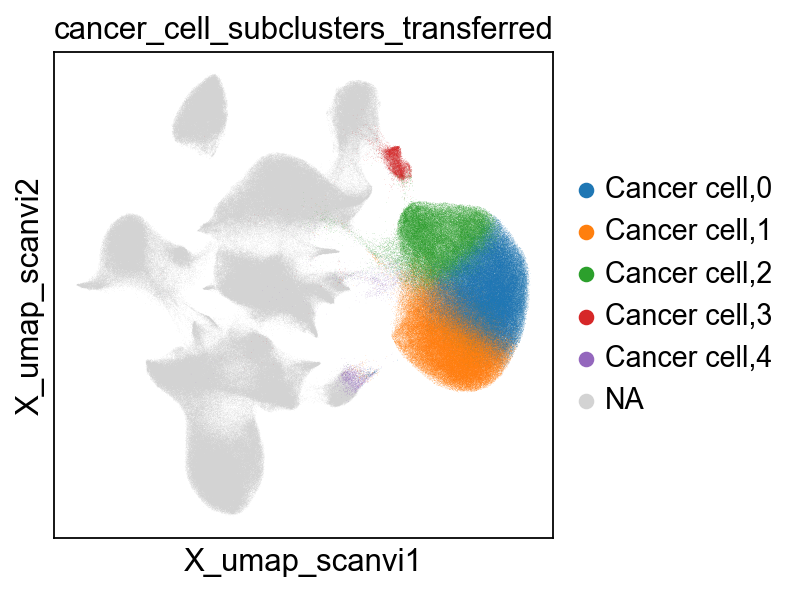

In [ ]:
from insitupy._constants import DEFAULT_CATEGORICAL_CMAP
sc.set_figure_params(dpi_save=600)
sc.pl.embedding(scanvi, basis="X_umap_scanvi",
                color=["cancer_cell_subclusters_transferred"],
                palette=DEFAULT_CATEGORICAL_CMAP.colors,
                save="_cancer_cell_subclusters.png",
                )

Use own color palette.

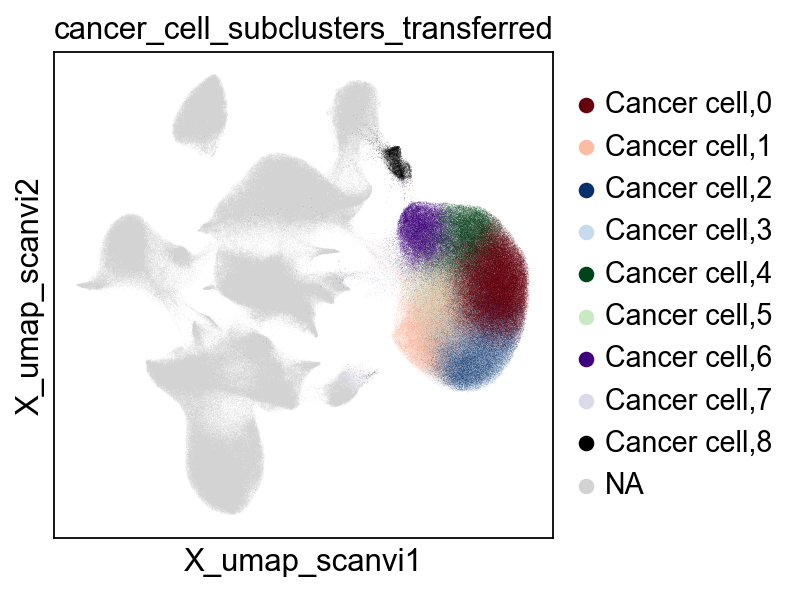

In [60]:
from insitupy.palettes import create_colormap
n_cats = len(scanvi.obs["cancer_cell_subclusters_transferred"].cat.categories)
sc.pl.embedding(scanvi, basis="X_umap_scanvi",
                color=["cancer_cell_subclusters_transferred"],
                palette=create_colormap(n_cats)
                )

## Transfer data from concatenated `AnnData` to `InSituExperiment`

In [4]:
data_path = Path(r"E:\ColorectalCancer\analysis\crc_data_pp_rounded_all_images")

In [5]:
exp = InSituExperiment.read(data_path)
exp.load_all()

100%|██████████| 7/7 [01:02<00:00,  8.96s/it]


In [6]:
exp

InSituExperiment with 7 samples:
           uid  CITAR  slide_id       sample_id  Region  ...  Metastasis type     H number              HE           panCK annotations_Tanja
0     3d377351  ++++-      3621  Region_1-14...       1  ...             NaN   1414/18 IIA  C:\Users\ge...  C:\Users\ge...  E:\Colorect...  
1     039bf1f8  ++++-      3621  Region_2-14...       2  ...     synchronous   1414/18 IIS  C:\Users\ge...  C:\Users\ge...  E:\Colorect...  
2     1c928862  ++++-      3621  Region_3-33...       3  ...    asynchronous   3311/18 IVA  C:\Users\ge...  C:\Users\ge...  E:\Colorect...  
3     18755ab6  ++++-      3621  Region_4-14...       4  ...     synchronous    1414/18 IC  C:\Users\ge...  C:\Users\ge...  E:\Colorect...  
4     3ee0776f  ++++-      3991  Region_1-53...       1  ...             NaN   5316/18 IVC  C:\Users\ge...  C:\Users\ge...  E:\Colorect...  
5     4e08eb69  ++++-      3991  Region_2-53...       2  ...     synchronous   5316/18 IVS  C:\Users\ge...  C:\Users\ge..

### Transfer information about cancer subtypes to `InSituExperiment`

Remove uids from `obs_names` since this makes problems with saving. The string of the cell names may not be longer than <U10> (unicode string with maximum length of 10). 

In [64]:
scanvi.obs_names = [elem.split("-")[1] for elem in scanvi.obs_names]

Remove integer from uid column.

In [65]:
scanvi.obs["uid"] = [elem.split("-")[1] for elem in scanvi.obs["uid"]]

In [66]:
scanvi.obs

,original_cell_id,centroid_x,centroid_y,centroid_z,fov,cluster,volume,scale,population,n_genes_by_counts,...,uid,predicted_labels,over_clustering,majority_voting,conf_score,majority_voting_simple,_scvi_batch,_scvi_labels,cancer_cell_subclusters_transferred,cancer_cell_subclusters_transferred_comb
1,gmmgeomd-1,1268.0000,1363.0500,1.487110,AA9,9,301.24756,1.0,52,17,...,c20dbd1b,Dendritic cell,244,Dendritic cell,0.452960,Dendritic cell,0,4,NaN,Dendritic cell
3,iegibfda-1,729.8018,2630.6646,-0.740097,AC8,3,823.40930,1.0,128,34,...,c20dbd1b,Fibroblast,259,Fibroblast,0.891073,Fibroblast,0,6,NaN,Fibroblast
4,mphmoeoi-1,1018.3509,786.2193,-0.092895,AA8,2,1144.73940,1.0,241,69,...,c20dbd1b,CD8,347,Macrophage,0.077021,Macrophage,0,8,NaN,Macrophage
5,lobmclka-1,1438.8810,698.3797,0.261800,Z9,5,1001.64780,1.0,305,85,...,c20dbd1b,CRLM,78,CRLM,0.550394,Cancer cell,0,3,"Cancer cell,1","Cancer cell,1"
6,idlimpbp-1,940.0360,1921.4200,-0.887722,AB8,1,941.39795,1.0,181,48,...,c20dbd1b,Plasma cell,1,Plasma cell,0.990887,Plasma cell,0,13,NaN,Plasma cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
231176,hojdeghj-1,3630.3252,1461.6993,0.076172,M8,9,614.35800,1.0,54,10,...,4e08eb69,Pericyte,58,Fibroblast,0.261630,Fibroblast,6,6,NaN,Fibroblast
231180,kimicoge-1,2212.3943,3078.4358,0.535801,O6,7,1604.63510,1.0,121,44,...,4e08eb69,CRLM,213,Cancer cell,0.223652,Cancer cell,6,3,"Cancer cell,0","Cancer cell,0"
231184,ecaglmpn-1,6489.0440,2337.0770,1.840549,N13,3,908.65070,1.0,60,15,...,4e08eb69,Fibroblast,122,Fibroblast,0.645473,Fibroblast,6,6,NaN,Fibroblast
231189,kjkgpaga-1,1967.9830,3660.1780,0.226134,P6,0,253.47653,1.0,53,33,...,4e08eb69,Cancer cell,175,Cancer cell,0.480489,Cancer cell,6,3,"Cancer cell,3","Cancer cell,3"


In [67]:
scanvi

AnnData object with n_obs × n_vars = 1018411 × 280
    obs: 'original_cell_id', 'centroid_x', 'centroid_y', 'centroid_z', 'fov', 'cluster', 'volume', 'scale', 'population', 'n_genes_by_counts', 'total_counts', 'n_counts', 'n_genes', 'uid', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'majority_voting_simple', '_scvi_batch', '_scvi_labels', 'cancer_cell_subclusters_transferred', 'cancer_cell_subclusters_transferred_comb'
    var: 'gene_names', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'X_umap_scanvi', 'X_umap_scvi', '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'neighbors', 'neighbors_scanvi', 'neighbors_scvi', 'over_clustering', 'pca', 'umap', 'cancer_cell_subclusters_transferred_colors'
    obsm: 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap', 'X_umap_scanvi', 'X_umap_scvi', 'spatial'
    varm: 'PCs'
    layers: 'counts', 'counts_proseg', 'counts_rounded', 'log1p', 'norm_counts', 'scaled_log1p'
    obsp: 'connectivities', '

In [68]:
exp.import_obs(
    adata=scanvi,
    uid_column="uid",
    uid_column_adata="uid",
    obs_columns_to_transfer=[
        "cancer_cell_subclusters_transferred",
        "cancer_cell_subclusters_transferred_comb"
        ],
    obsm_keys_to_transfer=None,
    cells_layer="proseg",
    overwrite=True
)

Create a uniform color palette across all the datasets in `InSituExperiment`.

In [69]:
obs_col = "cancer_cell_subclusters_transferred_comb"

In [70]:
cols = []
for meta, xd in exp.iterdata():
    cols.append(np.unique(xd.cells["proseg"].matrix.obs[obs_col]))
all_cats = np.sort(np.unique(np.concatenate(cols)))

In [71]:
all_cats

array(['B cell', 'CD4', 'CD8', 'Cancer cell,0', 'Cancer cell,1',
       'Cancer cell,2', 'Cancer cell,3', 'Cancer cell,4', 'Cancer cell,5',
       'Cancer cell,6', 'Cancer cell,7', 'Cancer cell,8',
       'Dendritic cell', 'Endothelial cell', 'Fibroblast', 'Hepatocyte',
       'Macrophage', 'Mast cell', 'Monocyte', 'Neutrophil', 'Pericyte',
       'Plasma cell', 'Schwann cell', 'Treg', 'gamma-delta'], dtype=object)

In [72]:
from insitupy._constants import DEFAULT_CATEGORICAL_CMAP
from matplotlib.colors import rgb2hex


In [73]:
from insitupy.palettes import map_to_colors

In [74]:
color_dict = map_to_colors(all_cats, DEFAULT_CATEGORICAL_CMAP)

In [75]:
color_dict

{'B cell': '#1f77b4',
 'CD4': '#ff7f0e',
 'CD8': '#2ca02c',
 'Cancer cell,0': '#d62728',
 'Cancer cell,1': '#9467bd',
 'Cancer cell,2': '#8c564b',
 'Cancer cell,3': '#e377c2',
 'Cancer cell,4': '#bcbd22',
 'Cancer cell,5': '#17becf',
 'Cancer cell,6': '#aec7e8',
 'Cancer cell,7': '#ffbb78',
 'Cancer cell,8': '#98df8a',
 'Dendritic cell': '#ff9896',
 'Endothelial cell': '#c5b0d5',
 'Fibroblast': '#c49c94',
 'Hepatocyte': '#f7b6d2',
 'Macrophage': '#dbdb8d',
 'Mast cell': '#9edae5',
 'Monocyte': '#7f7f7f',
 'Neutrophil': '#c7c7c7',
 'Pericyte': '#1f77b4',
 'Plasma cell': '#ff7f0e',
 'Schwann cell': '#2ca02c',
 'Treg': '#d62728',
 'gamma-delta': '#9467bd'}

In [76]:
for meta, xd in exp.iterdata():
    cats = np.unique(xd.cells["proseg"].matrix.obs[obs_col])
    xd.cells["proseg"].matrix.uns[f"{obs_col}_colors"] = [color_dict[c] for c in cats]

Now the colors are synced across all plots.

Saving figure to file figures/X_umap_scanvi-cell_types-all_datasets_05.png
Saved.


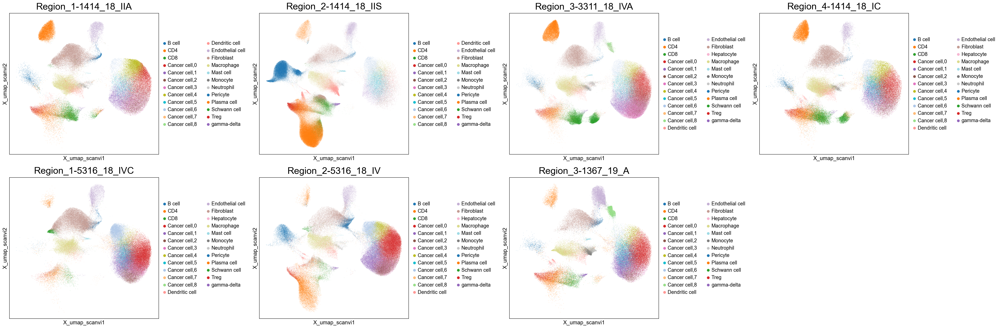

In [79]:
exp.plot_embedding(
    basis="X_umap_scanvi",
    cells_layer="proseg",
    color=["cancer_cell_subclusters_transferred_comb"],
    title_column="sample_id",
    savepath="figures/X_umap_scanvi-cell_types-all_datasets_05.png",
    dpi_save=600, figsize=(9,6)
)

## Save `InSituExperiment`

Set the proseg data as main `CellData`.

In [80]:
for _, xd in exp.iterdata():
    xd.cells.set_main('proseg')

In [81]:
exp.save()

100%|██████████| 7/7 [02:55<00:00, 25.12s/it]


### Reload data

In [3]:
data_path = Path(r"E:\ColorectalCancer\analysis\crc_data_pp_rounded_all_images")
exp = InSituExperiment.read(data_path)
exp.load_all()

100%|██████████| 7/7 [00:54<00:00,  7.85s/it]


## Import new annotations

The annotations have changed a bit in the meantime. Here we reload the new annotations from QuPath.

In [4]:
exp.append_metadata(
    new_metadata=r"E:\ColorectalCancer\annotations_Tanja\exports\import_annotations_config.xlsx",
    by="sample_id", overwrite=True
)

In [5]:
for meta, xd in exp.iterdata():
    # remove data from key
    xd.annotations.remove_key("Tanja")

    # import new annotations
    p = meta["annotations_Tanja"]
    xd.import_annotations(
        files=p, keys="Tanja", scale_factor=0.2125
)

In [6]:
xd

InSituData
Method:		Xenium
Slide ID:	0003991
Sample ID:	Region_3-1367_19_A
Path:		E:\ColorectalCancer\analysis\crc_data_pp_rounded_all_images\data-006
Metadata file:	.ispy
    ➤ images
       nuclei:	(23911, 22817)
       HE:	(23911, 22817, 3)
       panCK:	(23911, 22817, 3)
    ➤ cells
       MultiCellData with main layer 'proseg'
           matrix
               AnnData object with n_obs × n_vars = 88757 × 280
               obs: 'original_cell_id', 'centroid_x', 'centroid_y', 'centroid_z', 'fov', 'cluster', 'volume', 'scale', 'population', 'n_genes_by_counts', 'total_counts', 'n_counts', 'n_genes', 'predicted_labels', 'majority_voting', 'majority_voting_simple', 'cancer_cell_subclusters_transferred', 'cancer_cell_subclusters_transferred_comb', 'cell_type', 'cancer_mask'
               var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
               uns: 'cancer_cell_subclusters_transferred_comb_colors', 'cell_type_colors', 'log1p', 'majo

### Add pneumocyte cell type annotation

Based on the histological stainings we found Cancer cell subtype 8 to be pneumocytes and not cancer cells. This annotation we will add here. In the following, we remove the comma from the cancer cell subtype names, add the pneumocyte annotation and save new annotation as `cell_type`. in `.obs`.

In [7]:
for meta, xd in exp.iterdata():
    xd.cells.matrix.obs["cell_type"] = xd.cells.matrix.obs["cancer_cell_subclusters_transferred_comb"]
    xd.cells.matrix.uns["cell_type_colors"] = xd.cells.matrix.uns["cancer_cell_subclusters_transferred_comb_colors"]
    xd.cells.matrix.obs["cell_type"] = xd.cells.matrix.obs["cell_type"].str.replace(",", " ")

    # rename cancer cell 8 into pneumocytes
    xd.cells.matrix.obs["cell_type"] = xd.cells.matrix.obs["cell_type"].str.replace("Cancer cell 8", "Pneumocyte")
    xd.cells.matrix.obs["majority_voting_simple"] = [a if b != "Pneumocyte" else b for a, b in zip(
        xd.cells.matrix.obs["majority_voting_simple"],
        xd.cells.matrix.obs["cell_type"]
        )]

In [8]:
xd.cells.matrix.obs["cell_type"].unique()

array(['Dendritic cell', 'Fibroblast', 'Macrophage', 'Cancer cell 1',
       'Plasma cell', 'Mast cell', 'Cancer cell 0', 'Cancer cell 2',
       'Endothelial cell', 'Neutrophil', 'CD4', 'Cancer cell 3', 'CD8',
       'Cancer cell 5', 'Pneumocyte', 'Pericyte', 'Treg', 'Monocyte',
       'Cancer cell 7', 'Cancer cell 4', 'gamma-delta', 'Cancer cell 6',
       'B cell', 'Hepatocyte', 'Schwann cell'], dtype=object)

Fix the colors of the cell type columns by adding a "{}_colors" key to `.uns` using the `.sync_colors` function.

In [9]:
exp.sync_colors(
    obs_cols=["majority_voting_simple", "cell_type"],
    cells_layer="proseg")

Saving synchronized color list into `.uns['majority_voting_simple_colors']...
Saving synchronized color list into `.uns['cell_type_colors']...


In [10]:
adata = exp.collect_anndatas(
    cells_layer="proseg", label_col="sample_id",
    obs_keys=["majority_voting_simple", "cell_type"],
    obsm_keys=["X_umap_scanvi", "annotations"],
    uns_keys='cell_type_colors'

    )

c:\Users\ge37voy\AppData\Local\miniconda3\envs\insitupy\lib\site-packages\anndata\_core\anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


After concatenation of the `AnnData` some of the `obs_names` can be duplicated. Here we make them unique again.

In [11]:
adata.obs_names_make_unique()

In [12]:
cancer = adata[adata.obs["cell_type"].str.contains("Cancer cell")].copy()

In [13]:
adata

AnnData object with n_obs × n_vars = 1018411 × 280
    obs: 'majority_voting_simple', 'cell_type', 'sample_id'
    obsm: 'X_umap_scanvi', 'annotations'

In [14]:
adata.obs["cell_type_cancer_only"] = [elem if "Cancer cell" in elem else np.nan for elem in adata.obs["cell_type"]]

In [15]:
import matplotlib.pyplot as plt

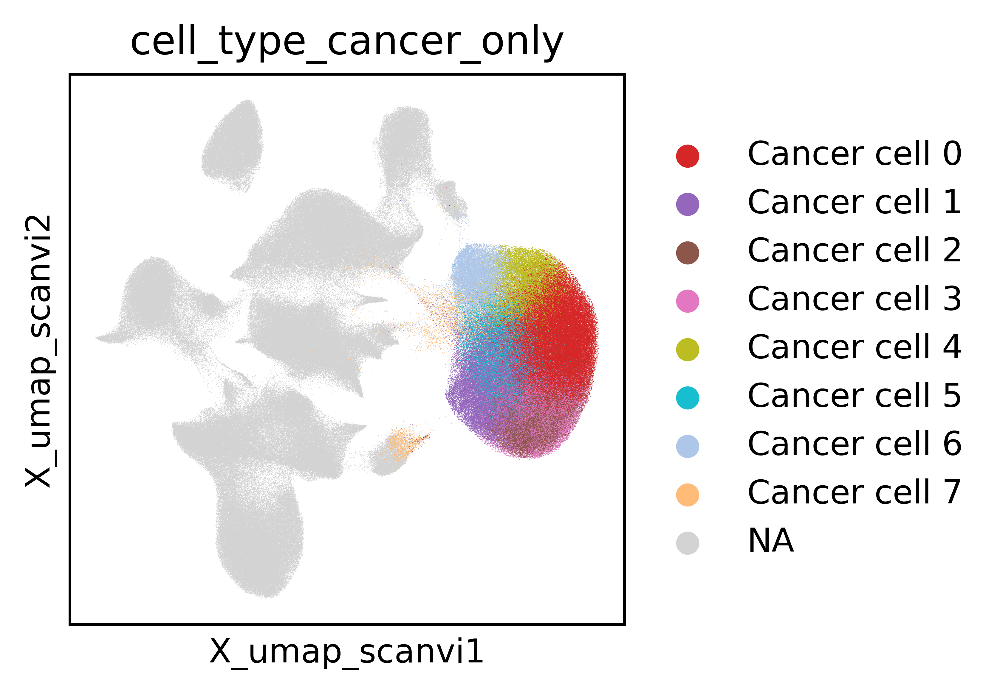

In [23]:
from insitupy._constants import DEFAULT_CATEGORICAL_CMAP
with plt.rc_context({"figure.figsize": (3, 3), "figure.dpi": (400)}):
    sc.pl.embedding(adata, basis="X_umap_scanvi",
                    color=["cell_type_cancer_only"],
                    palette=exp.colors["cell_type"],
                    #palette=DEFAULT_CATEGORICAL_CMAP.colors,
                    save="_cancer_cell_subclusters_05.png",
                    )

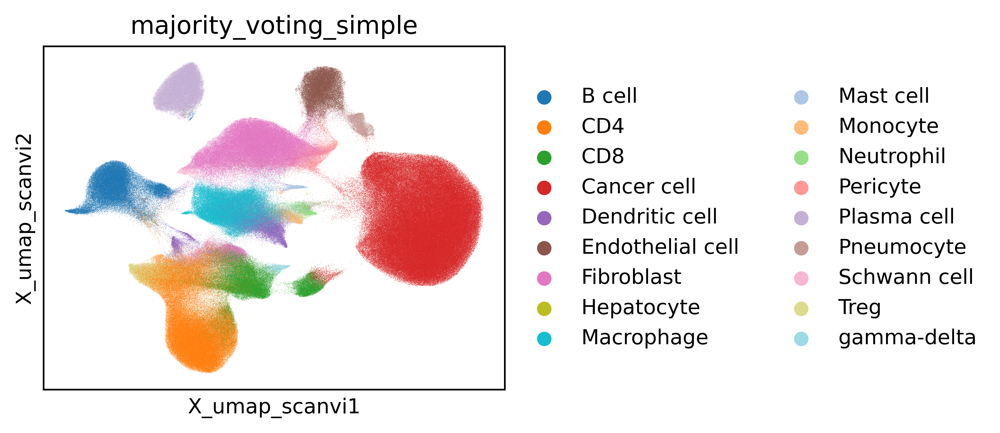

In [93]:
from insitupy._constants import DEFAULT_CATEGORICAL_CMAP
#sc.set_figure_params(dpi_save=600)
with plt.rc_context({"figure.figsize": (4, 3), "figure.dpi": (400)}):
    sc.pl.embedding(adata, basis="X_umap_scanvi",
                    color=["majority_voting_simple"],
                    palette=exp.colors["majority_voting_simple"],
                    #palette=DEFAULT_CATEGORICAL_CMAP.colors,
                    save="_majority_voting_simple.png",
                    )

In [94]:
from insitupy.plotting import plot_spatial

Saving figure to file figures/spatial-all-majority_voting_simple.png
Saved.


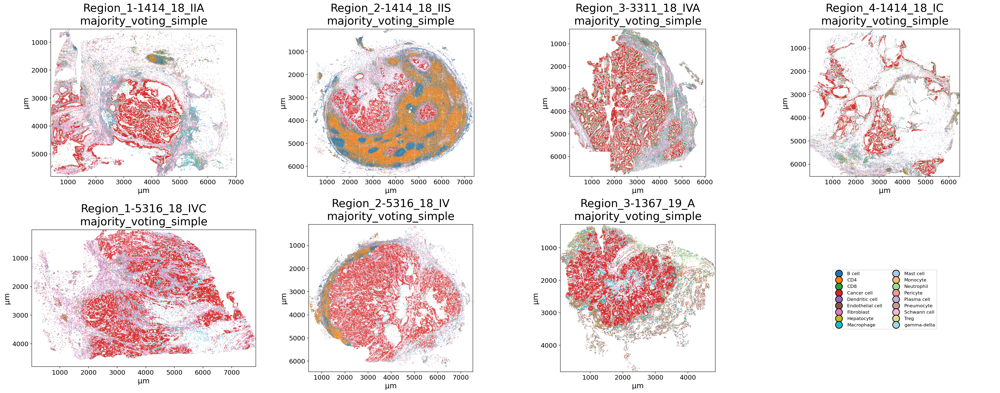

In [96]:
plot_spatial(
    exp, keys="majority_voting_simple", cells_layer="proseg",
    savepath="figures/spatial-all-majority_voting_simple.png"
)

In [97]:
exp.show(4)

Viewer(camera=Camera(center=(0.0, np.float64(2539.5875), np.float64(3929.3375)), zoom=np.float64(0.035176734620517215), angles=(0.0, 0.0, 90.0), perspective=0.0, mouse_pan=True, mouse_zoom=True), cursor=Cursor(position=(1.0, 1.0), scaled=True, style=<CursorStyle.STANDARD: 'standard'>, size=1.0), dims=Dims(ndim=2, ndisplay=2, order=(0, 1), axis_labels=('0', '1'), rollable=(True, True), range=(RangeTuple(start=np.float64(0.0), stop=np.float64(5079.175), step=np.float64(0.2125)), RangeTuple(start=np.float64(0.0), stop=np.float64(7858.675), step=np.float64(0.2125))), margin_left=(0.0, 0.0), margin_right=(0.0, 0.0), point=(np.float64(2539.5875), np.float64(3929.3375)), last_used=0), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Image layer 'nuclei' at 0x253633a2d40>, <Image layer 'HE' at 0x25340b89b40>, <Image layer 'panCK' at 0x24e43c95000>], help='use <2> for transform', status='Ready', tooltip=Tooltip(visible=False, text=''), theme='dark', title='0003991: Region_1-53

Remove main cell data key to save space.

In [23]:
for meta, xd in exp.iterdata():
    del xd.cells["main"]

## Save the results

In [25]:
exp.saveas(r"E:\ColorectalCancer\analysis\proseg_only")

100%|██████████| 7/7 [08:38<00:00, 74.06s/it]
